# License
our code uses the MIT license. Part of our implementation is inspired by the code from [habitat_sim (MIT license)](https://aihabitat.org/), [LSeg (MIT license)](https://github.com/isl-org/lang-seg), and [CLIP (MIT license)](https://github.com/openai/CLIP). We would like to express our gratitude to the developers of these projects.

# VLMap Creation

## Download the data and install dependencies

In [5]:
# Ensure that you are in the correct conda env
!conda info --envs

# conda environments:
#
base                     C:\Users\Marlo\anaconda3
clipseg                  C:\Users\Marlo\anaconda3\envs\clipseg
instantsplat             C:\Users\Marlo\anaconda3\envs\instantsplat
ir-specter2              C:\Users\Marlo\anaconda3\envs\ir-specter2
irpresentation           C:\Users\Marlo\anaconda3\envs\irpresentation
msc-env                  C:\Users\Marlo\anaconda3\envs\msc-env
msc-reqs-env             C:\Users\Marlo\anaconda3\envs\msc-reqs-env
msc-reqs2-env            C:\Users\Marlo\anaconda3\envs\msc-reqs2-env
msc-reqs3-env            C:\Users\Marlo\anaconda3\envs\msc-reqs3-env
unibots-env2             C:\Users\Marlo\anaconda3\envs\unibots-env2
vlmaps-env               C:\Users\Marlo\anaconda3\envs\vlmaps-env
vlmaps-gpu-env           C:\Users\Marlo\anaconda3\envs\vlmaps-gpu-env
vlmaps-gpu2-env          C:\Users\Marlo\anaconda3\envs\vlmaps-gpu2-env
vlmaps-gpu3-env          C:\Users\Marlo\anaconda3\envs\vlmaps-gpu3-env
vlmaps-gpu4-env          C:\Users\Marlo\ana

In [6]:
# Should be at least CUDA 11.0 or higher
!nvidia-smi

Tue Apr 29 17:57:30 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 566.14                 Driver Version: 566.14         CUDA Version: 12.7     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 4060 ...  WDDM  |   00000000:01:00.0 Off |                  N/A |
| N/A   47C    P0             15W /   84W |       0MiB /   8188MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [7]:
# Specific Build Version should be CUDA 11.0
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Thu_Jun_11_22:26:48_Pacific_Daylight_Time_2020
Cuda compilation tools, release 11.0, V11.0.194
Build cuda_11.0_bu.relgpu_drvr445TC445_37.28540450_0


In [8]:
# Ensure that you use CUDA 11.0 and it works!!!
import torch
print("PyTorch version:", torch.__version__) # Should output "Pytorch version: 1.7.1"
print(torch.version.cuda) # Should output "11.0"
print(torch.cuda.is_available()) # Should return "True" if GPU support is active

PyTorch version: 1.7.1
11.0
True


In [5]:
!pip list

Package                   Version
------------------------- --------------
absl-py                   2.2.2
ai2thor                   5.0.0
aiohappyeyeballs          2.4.4
aiohttp                   3.10.11
aiosignal                 1.3.1
altair                    4.1.0
anyio                     4.2.0
argon2-cffi               21.3.0
argon2-cffi-bindings      21.2.0
arrow                     1.3.0
asttokens                 2.0.5
async-lru                 2.0.4
async-timeout             5.0.1
attrs                     24.2.0
aws-requests-auth         0.4.3
Babel                     2.11.0
backcall                  0.2.0
beautifulsoup4            4.12.3
bleach                    4.1.0
blinker                   1.8.2
botocore                  1.37.38
Brotli                    1.0.9
cachetools                5.5.2
catkin-pkg                1.0.0
certifi                   2024.8.30
cffi                      1.17.1
charset-normalizer        3.3.2
click                     8.1.8
cloudpickle    

In [9]:
import sys
print(sys.executable)

C:\Users\Marlo\anaconda3\envs\vlmaps-gpu8-env\python.exe


In [10]:
!where pip

C:\Users\Marlo\anaconda3\envs\vlmaps-gpu8-env\Scripts\pip.exe
C:\Python313\Scripts\pip.exe
C:\Users\Marlo\AppData\Local\Programs\Python\Python310\Scripts\pip.exe


In [8]:
import sys
!{sys.executable} -m pip list

Package                   Version
------------------------- --------------
absl-py                   2.1.0
ai2thor                   5.0.0
aiohappyeyeballs          2.4.4
aiohttp                   3.10.11
aiosignal                 1.3.1
altair                    4.1.0
anyio                     4.5.2
argon2-cffi               23.1.0
argon2-cffi-bindings      21.2.0
arrow                     1.3.0
asttokens                 2.0.5
async-lru                 2.0.4
async-timeout             5.0.1
attrs                     25.3.0
aws-requests-auth         0.4.3
babel                     2.17.0
backcall                  0.2.0
beautifulsoup4            4.13.3
bleach                    6.1.0
blinker                   1.8.2
botocore                  1.37.15
cachetools                5.5.2
catkin-pkg                1.0.0
certifi                   2025.1.31
cffi                      1.17.1
charset-normalizer        3.4.1
click                     8.1.8
clip                      1.0
cloudpickle      


[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [11]:
root_dir = !pwd
root_dir = root_dir[0]

In [12]:
!mkdir -p data
%cd data

C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data


Ein Unterverzeichnis oder eine Datei mit dem Namen "-p" existiert bereits.
Folgender Fehler trat auf: -p.
Ein Unterverzeichnis oder eine Datei mit dem Namen "data" existiert bereits.
Folgender Fehler trat auf: data.


In [13]:
!gdown 1wjuiVcO92Rqer5gLk-X7hINfe4PCMQmu

^C


Downloading...
From: https://drive.google.com/uc?id=1wjuiVcO92Rqer5gLk-X7hINfe4PCMQmu
To: C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1.zip

  0%|          | 0.00/2.75G [00:00<?, ?B/s]
  0%|          | 1.57M/2.75G [00:00<05:20, 8.59MB/s]
  0%|          | 3.15M/2.75G [00:00<05:05, 9.00MB/s]
  0%|          | 4.72M/2.75G [00:00<04:15, 10.8MB/s]
  0%|          | 6.29M/2.75G [00:00<04:03, 11.3MB/s]
  0%|          | 7.86M/2.75G [00:00<03:47, 12.1MB/s]
  0%|          | 9.44M/2.75G [00:00<03:38, 12.5MB/s]
  0%|          | 11.0M/2.75G [00:01<04:26, 10.3MB/s]
  0%|          | 12.6M/2.75G [00:01<04:13, 10.8MB/s]
  1%|          | 14.2M/2.75G [00:01<04:14, 10.8MB/s]
  1%|          | 15.7M/2.75G [00:01<03:59, 11.4MB/s]
  1%|          | 17.3M/2.75G [00:01<03:45, 12.1MB/s]
  1%|          | 18.9M/2.75G [00:01<03:40, 12.4MB/s]
  1%|          | 20.4M/2.75G [00:01<03:41, 12.3MB/s]
  1%|          | 22.0M/2.75G [00:01<03:37, 12.5MB/s]
  1%|         

In [14]:
!pip install tqdm


[notice] A new release of pip is available: 24.0 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [14]:
# Just unzip manually on Windows!!!
# MAKE SURE that the LAST "5LpN3gDmAk7_1" folder is at same level as the .zip (unzipping will give another 5LpN3gDmAk7_1 within a 5LpN3gDmAk7_1 folder)
# !unzip -o 5LpN3gDmAk7_1.zip | tqdm --desc extracted --unit files --unit_scale --total `unzip -l 5LpN3gDmAk7_1.zip | tail -n 1 | xargs echo -n | cut -d' ' -f2` > /dev/null

In [23]:
%cd ..

C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes


In [24]:
import os
data_dir = os.path.join(root_dir, "data", "5LpN3gDmAk7_1")

In [25]:
# Windows doesn't support pwd -> set paths manually
data_dir = r"C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1"
root_dir = r"C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis"

In [11]:
# Additional Windows Installation needed
# !pip install "imageio[ffmpeg]"

## Visualize the Dataset

In [19]:
# !pip install opencv-python

In [26]:
# @title Helper functions for video creation and display
import sys
import os
import imageio
import numpy as np
import cv2
import tqdm
from IPython.display import HTML
from base64 import b64encode

if "google.colab" in sys.modules:
    os.environ["IMAGEIO_FFMPEG_EXE"] = "/usr/bin/ffmpeg"

# @markdown if the colab instance doesn't have GPU, untick the following checkbox
has_gpu = True # @param {type: "boolean"}
codec = "h264"
if has_gpu:
  codec = "h264_nvenc"

def load_depth(depth_filepath):
    with open(depth_filepath, 'rb') as f:
        depth = np.load(f)
    return depth



def get_fast_video_writer(video_file: str, fps: int = 60):
    if (
        "google.colab" in sys.modules
        and os.path.splitext(video_file)[-1] == ".mp4"
        and os.environ.get("IMAGEIO_FFMPEG_EXE") == "/usr/bin/ffmpeg"
    ):
        # USE GPU Accelerated Hardware Encoding
        writer = imageio.get_writer(
            video_file,
            fps=fps,
            codec=codec,
            mode="I",
            bitrate="1000k",
            format="FFMPEG",
            ffmpeg_log_level="info",
            quality=10,
            output_params=["-minrate", "500k", "-maxrate", "5000k"],
        )
    else:
        # Use software encoding
        writer = imageio.get_writer(video_file, fps=fps)
    return writer

def create_video(data_dir: str, output_dir: str, fps: int = 30):
    
    rgb_dir = os.path.join(data_dir, "rgb")
    depth_dir = os.path.join(data_dir, "depth")
    rgb_out_path = os.path.join(output_dir, "rgb.mp4")
    depth_out_path = os.path.join(output_dir, "depth.mp4")
    rgb_writer = get_fast_video_writer(rgb_out_path, fps=fps)
    depth_writer = get_fast_video_writer(depth_out_path, fps=fps)

    rgb_list = sorted(os.listdir(rgb_dir), key=lambda x: int(
        x.split("_")[-1].split(".")[0]))
    depth_list = sorted(os.listdir(depth_dir), key=lambda x: int(
        x.split("_")[-1].split(".")[0]))

    rgb_list = [os.path.join(rgb_dir, x) for x in rgb_list]
    depth_list = [os.path.join(depth_dir, x) for x in depth_list]
    pbar = tqdm.tqdm(total=len(rgb_list), position=0, leave=True)
    for i, (rgb_path, depth_path) in enumerate(zip(rgb_list, depth_list)):
        bgr = cv2.imread(rgb_path)
        rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)

        depth = load_depth(depth_path)
        depth_vis = (depth / 10 * 255).astype(np.uint8)

        depth_color = cv2.applyColorMap(depth_vis, cv2.COLORMAP_JET)

        rgb_writer.append_data(rgb)
        depth_writer.append_data(depth_color)
        pbar.update(1)
    rgb_writer.close()
    depth_writer.close()

def show_video(video_path, video_width = 1080):
   
    video_file = open(video_path, "r+b").read()
  
    video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"
    return HTML(f"""<video width={video_width} autoplay controls><source src="{video_url}"></video>""")

def show_videos(video_paths, video_width = 1080):
    html = ""
    for video_path in video_paths:
        video_file = open(video_path, "r+b").read()
      
        video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"
        html += f"""<video width={video_width} autoplay controls><source src="{video_url}"></video>
                 """
    return HTML(html)



In [19]:
create_video(data_dir, root_dir, fps=30)

  0%|                                                                                                                          | 0/1159 [00:00<?, ?it/s]IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (1080, 720) to (1088, 720) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).
IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (1080, 720) to (1088, 720) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1159/1159 [00:39<00:00, 29.59it/s]


In [20]:
# show rgb and depth
show_videos([root_dir + "/rgb.mp4", root_dir + "/depth.mp4"])

## Download LSeg checkpoint

In [15]:
%cd {root_dir + "/lseg"}
!mkdir checkpoints
%cd checkpoints
!gdown 1ayk6NXURI_vIPlym16f_RG3ffxBWHxvb

C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\lseg
C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\lseg\checkpoints


Ein Unterverzeichnis oder eine Datei mit dem Namen "checkpoints" existiert bereits.
Downloading...
From: https://drive.google.com/uc?id=1ayk6NXURI_vIPlym16f_RG3ffxBWHxvb
To: C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\lseg\checkpoints\demo_e200.ckpt

  0%|          | 0.00/3.10G [00:00<?, ?B/s]
  0%|          | 1.57M/3.10G [00:00<05:23, 9.58MB/s]
  0%|          | 3.67M/3.10G [00:00<03:38, 14.2MB/s]
  0%|          | 5.77M/3.10G [00:00<03:21, 15.3MB/s]
  0%|          | 7.86M/3.10G [00:00<03:15, 15.8MB/s]
  0%|          | 9.96M/3.10G [00:00<03:07, 16.4MB/s]
  0%|          | 12.1M/3.10G [00:00<03:05, 16.7MB/s]
  0%|          | 14.2M/3.10G [00:00<03:00, 17.0MB/s]
  1%|          | 16.3M/3.10G [00:01<02:58, 17.3MB/s]
  1%|          | 18.4M/3.10G [00:01<03:25, 15.0MB/s]
  1%|          | 19.9M/3.10G [00:01<03:30, 14.6MB/s]
  1%|          | 21.5M/3.10G [00:01<03:36, 14.2MB/s]
  1%|          | 23.6M/3.10G [00:01<03:31, 14.5MB/s]
  1%|          | 25.7M/3.10

In [28]:
!dir
%cd {root_dir}

 Datentr„ger in Laufwerk C: ist Acer
 Volumeseriennummer: A2B1-BCB4

 Verzeichnis von C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis

29.04.2025  17:59    <DIR>          .
29.04.2025  16:25    <DIR>          ..
23.03.2025  15:46    <DIR>          -p
23.03.2025  15:43               554 .flake8
29.04.2025  16:25    <DIR>          .github
23.03.2025  15:43               193 .gitignore
29.04.2025  16:25    <DIR>          .ipynb_checkpoints
23.03.2025  15:43               943 .pre-commit-config.yaml
23.03.2025  15:45               114 9.3.0
23.03.2025  15:45                51 constraints.txt
29.04.2025  17:57    <DIR>          data
29.04.2025  17:59        34.327.807 demo.ipynb
29.04.2025  17:59         8.024.111 depth.mp4
29.04.2025  16:25    <DIR>          examples
29.04.2025  17:29               220 install.bash
23.03.2025  15:43             1.105 LICENSE
29.04.2025  16:25    <DIR>          lseg
29.04.2025  16:25    <DIR>          media
23.03.2025  

## VLMap Creation
It takes around 20 minutes to build a VLMap with around 1000 RGBD frames. We also provide a pre-built VLMap. Skip to the Landmark Indexing part of the code to directly try our map.

In [29]:
# setup parameters
# @markdown meters per cell size
cs = 0.05 # @param {type: "number"}
# @markdown map resolution (gs x gs)
gs = 1000 # @param {type: "integer"}
# @markdown camera height (used for filtering out points on the floor)
camera_height = 1.5 # @param {type: "number"}
# @markdown depth pixels subsample rate
depth_sample_rate = 100 # @param {type: "integer"}
# @markdown data where rgb, depth, pose are loaded and map are saved
data_dir = data_dir # @param {type: "string"}

In [2]:
# OpenAI CLIP model needed
# !pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to c:\users\marlo\appdata\local\temp\pip-req-build-xtvzar5p
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Using cached ftfy-6.2.3-py3-none-any.whl.metadata (7.8 kB)
  Using cached wcwidth-0.2.13-py2.py3-none-any.whl.metadata (14 kB)
Using cached ftfy-6.2.3-py3-none-any.whl (43 kB)
Using cached wcwidth-0.2.13-py2.py3-none-any.whl (34 kB)
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369610 sha256=c7d396b8007bb2e752af3829589784d8e0dcb034aa4d7275b1f32310994dc701
  Stored in directory: C:\Users\Marlo\AppData\Local\Temp\pip-ephem-wheel-cache-l0ze11xs\wheels\ab\4f\3a\5e51521b55997aa6f0690e095c08824219753128ce8d9969a3
Successfully built clip
  Attempting uninstall: wcwidth
    Found existing installation: wcwidth 0.2.5
    Uninstalling wcwidth-0.2.5:
      Successfully uninst

  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git 'C:\Users\Marlo\AppData\Local\Temp\pip-req-build-xtvzar5p'


In [19]:
# !pip install pandas

In [20]:
# !pip install timm

In [21]:
# !pip install pytorch-lightning

In [22]:
# # Monkey-Patch to fix irrelevant outdated torch function
# import torch
# if not hasattr(torch, '_running_with_deploy'):
#     torch._running_with_deploy = lambda: False

In [23]:
# Additional Manual Installs

In [33]:
!conda list

# packages in environment at C:\Users\Marlo\anaconda3\envs\vlmaps-gpu6-env:
#
# Name                    Version                   Build  Channel
absl-py                   2.1.0                    pypi_0    pypi
ai2thor                   5.0.0                    pypi_0    pypi
aiohappyeyeballs          2.4.4                    pypi_0    pypi
aiohttp                   3.10.11                  pypi_0    pypi
aiosignal                 1.3.1                    pypi_0    pypi
altair                    4.1.0                    pypi_0    pypi
anyio                     4.5.2                    pypi_0    pypi
argon2-cffi               23.1.0                   pypi_0    pypi
argon2-cffi-bindings      21.2.0                   pypi_0    pypi
arrow                     1.3.0                    pypi_0    pypi
asttokens                 2.0.5              pyhd3eb1b0_0  
async-lru                 2.0.4                    pypi_0    pypi
async-timeout             5.0.1                    pypi_0    pypi
att

In [34]:
# !pip install pillow==9.4.0

In [35]:
# !conda install pillow

In [36]:
# Ensure Torch 1.7.1 and CUDA 11.0 were not upgraded
import torch
print(torch.__version__)
print(torch.version.cuda)
print(torch.cuda.is_available())

1.7.1
11.0
True


In [25]:
!pip uninstall -y pillow

Found existing installation: Pillow 9.3.0
Uninstalling Pillow-9.3.0:
  Successfully uninstalled Pillow-9.3.0


In [26]:
pip install --no-cache-dir --upgrade pillow --constraint constraints.txt

   ---------------------------------------- 0.0/2.6 MB ? eta -:--:--
   ------------------------------------ --- 2.4/2.6 MB 13.4 MB/s eta 0:00:01
   ---------------------------------------- 2.6/2.6 MB 13.3 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [28]:
!pip uninstall -y pillow

Found existing installation: pillow 10.4.0
Uninstalling pillow-10.4.0:
  Successfully uninstalled pillow-10.4.0


You can safely remove it manually.


In [29]:
pip install --no-cache-dir --upgrade pillow --constraint constraints.txt

   ---------------------------------------- 0.0/2.6 MB ? eta -:--:--
   -------------------------------- ------- 2.1/2.6 MB 11.8 MB/s eta 0:00:01
   ---------------------------------------- 2.6/2.6 MB 11.3 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [30]:
!pip list

Package                   Version
------------------------- --------------
absl-py                   2.2.2
ai2thor                   5.0.0
aiohappyeyeballs          2.4.4
aiohttp                   3.10.11
aiosignal                 1.3.1
altair                    4.1.0
anyio                     4.2.0
argon2-cffi               21.3.0
argon2-cffi-bindings      21.2.0
arrow                     1.3.0
asttokens                 2.0.5
async-lru                 2.0.4
async-timeout             5.0.1
attrs                     24.2.0
aws-requests-auth         0.4.3
Babel                     2.11.0
backcall                  0.2.0
beautifulsoup4            4.12.3
bleach                    4.1.0
blinker                   1.8.2
botocore                  1.37.38
Brotli                    1.0.9
cachetools                5.5.2
catkin-pkg                1.0.0
certifi                   2024.8.30
cffi                      1.17.1
charset-normalizer        3.3.2
click                     8.1.8
cloudpickle    

In [32]:
!conda list

# packages in environment at C:\Users\Marlo\anaconda3\envs\vlmaps-gpu8-env:
#
# Name                    Version                   Build  Channel
absl-py                   2.2.2                    pypi_0    pypi
ai2thor                   5.0.0                    pypi_0    pypi
aiohappyeyeballs          2.4.4                    pypi_0    pypi
aiohttp                   3.10.11                  pypi_0    pypi
aiosignal                 1.3.1                    pypi_0    pypi
altair                    4.1.0                    pypi_0    pypi
anyio                     4.5.2                    pypi_0    pypi
argon2-cffi               23.1.0                   pypi_0    pypi
argon2-cffi-bindings      21.2.0           py38h2bbff1b_0  
arrow                     1.3.0                    pypi_0    pypi
asttokens                 2.0.5              pyhd3eb1b0_0  
async-lru                 2.0.4            py38haa95532_0  
async-timeout             5.0.1                    pypi_0    pypi
attrs          

In [30]:
# @title Helper functions for VLMap Creation

import os
import math

import numpy as np
import cv2
from tqdm import tqdm
import torch
import torchvision.transforms as transforms
import clip

from utils.clip_mapping_utils import load_pose, load_semantic, load_obj2cls_dict, save_map, cvt_obj_id_2_cls_id, depth2pc, transform_pc, get_sim_cam_mat, pos2grid_id, project_point

from lseg.modules.models.lseg_net import LSegEncNet
from lseg.additional_utils.models import resize_image, pad_image, crop_image

def create_lseg_map_batch(img_save_dir, camera_height, cs=0.05, gs=1000, depth_sample_rate=100):
    mask_version = 1 # 0, 1

    crop_size = 480 # 480
    base_size = 520 # 520
    lang = "door,chair,ground,ceiling,other"
    labels = lang.split(",")

    # loading models
    device = "cuda" if torch.cuda.is_available() else "cpu"
    print(device)
    clip_version = "ViT-B/32"
    clip_feat_dim = {'RN50': 1024, 'RN101': 512, 'RN50x4': 640, 'RN50x16': 768,
                    'RN50x64': 1024, 'ViT-B/32': 512, 'ViT-B/16': 512, 'ViT-L/14': 768}[clip_version]
    print("Loading CLIP model...")
    clip_model, preprocess = clip.load(clip_version)  # clip.available_models()
    clip_model.to(device).eval()
    lang_token = clip.tokenize(labels)
    lang_token = lang_token.to(device)
    with torch.no_grad():
        text_feats = clip_model.encode_text(lang_token)
        text_feats = text_feats / text_feats.norm(dim=-1, keepdim=True)
    text_feats = text_feats.cpu().numpy()
    model = LSegEncNet(lang, arch_option=0,
                        block_depth=0,
                        activation='lrelu',
                        crop_size=crop_size)
    model_state_dict = model.state_dict()
    pretrained_state_dict = torch.load("lseg/checkpoints/demo_e200.ckpt")
    pretrained_state_dict = {k.lstrip('net.'): v for k, v in pretrained_state_dict['state_dict'].items()}
    model_state_dict.update(pretrained_state_dict)
    model.load_state_dict(pretrained_state_dict)

    model.eval()
    model = model.cuda()

    norm_mean= [0.5, 0.5, 0.5]
    norm_std = [0.5, 0.5, 0.5]
    padding = [0.0] * 3
    transform = transforms.Compose(
        [
            transforms.ToTensor(),
            transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5]),
        ]
    )

    print(f"loading scene {img_save_dir}")
    rgb_dir = os.path.join(img_save_dir, "rgb")
    depth_dir = os.path.join(img_save_dir, "depth")
    pose_dir = os.path.join(img_save_dir, "pose")
    semantic_dir = os.path.join(img_save_dir, "semantic")
    obj2cls_path = os.path.join(img_save_dir, "obj2cls_dict.txt")

    rgb_list = sorted(os.listdir(rgb_dir), key=lambda x: int(
        x.split("_")[-1].split(".")[0]))
    depth_list = sorted(os.listdir(depth_dir), key=lambda x: int(
        x.split("_")[-1].split(".")[0]))
    pose_list = sorted(os.listdir(pose_dir), key=lambda x: int(
        x.split("_")[-1].split(".")[0]))
    pose_list = sorted(os.listdir(pose_dir), key=lambda x: int(
        x.split("_")[-1].split(".")[0]))
    semantic_list = sorted(os.listdir(semantic_dir), key=lambda x: int(
        x.split("_")[-1].split(".")[0]))

    rgb_list = [os.path.join(rgb_dir, x) for x in rgb_list]
    depth_list = [os.path.join(depth_dir, x) for x in depth_list]
    pose_list = [os.path.join(pose_dir, x) for x in pose_list]
    semantic_list = [os.path.join(semantic_dir, x) for x in semantic_list]


    map_save_dir = os.path.join(img_save_dir, "map")
    os.makedirs(map_save_dir, exist_ok=True)
    color_top_down_save_path = os.path.join(map_save_dir, f"color_top_down_{mask_version}.npy")
    gt_save_path = os.path.join(map_save_dir, f"grid_{mask_version}_gt.npy")
    grid_save_path = os.path.join(map_save_dir, f"grid_lseg_{mask_version}.npy")
    weight_save_path = os.path.join(map_save_dir, f"weight_lseg_{mask_version}.npy")
    obstacles_save_path = os.path.join(map_save_dir, "obstacles.npy")

    obj2cls = load_obj2cls_dict(obj2cls_path)

    # initialize a grid with zero position at the center
    color_top_down_height = (camera_height + 1) * np.ones((gs, gs), dtype=np.float32)
    color_top_down = np.zeros((gs, gs, 3), dtype=np.uint8)
    gt = np.zeros((gs, gs), dtype=np.int32)
    grid = np.zeros((gs, gs, clip_feat_dim), dtype=np.float32)
    obstacles = np.ones((gs, gs), dtype=np.uint8)
    weight = np.zeros((gs, gs), dtype=float)

    save_map(color_top_down_save_path, color_top_down)
    save_map(gt_save_path, gt)
    save_map(grid_save_path, grid)
    save_map(weight_save_path, weight)
    save_map(obstacles_save_path, obstacles)

    tf_list = []
    data_iter = zip(rgb_list, depth_list, semantic_list, pose_list)
    pbar = tqdm(total=len(rgb_list))
    # load all images and depths and poses
    for data_sample in data_iter:
        rgb_path, depth_path, semantic_path, pose_path = data_sample
        
        bgr = cv2.imread(rgb_path)
        rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)

        # read pose
        pos, rot = load_pose(pose_path)  # z backward, y upward, x to the right
        rot_ro_cam = np.eye(3)
        rot_ro_cam[1, 1] = -1
        rot_ro_cam[2, 2] = -1
        rot = rot @ rot_ro_cam
        pos[1] += camera_height


        pose = np.eye(4)
        pose[:3, :3] = rot
        pose[:3, 3] = pos.reshape(-1)

        tf_list.append(pose)
        if len(tf_list) == 1:
            init_tf_inv = np.linalg.inv(tf_list[0]) 

        tf = init_tf_inv @ pose

        # read depth
        depth = load_depth(depth_path)

        # read semantic
        semantic = load_semantic(semantic_path)
        semantic = cvt_obj_id_2_cls_id(semantic, obj2cls)

        pix_feats = get_lseg_feat(model, rgb, labels, transform, crop_size, base_size, norm_mean, norm_std)
        
        # transform all points to the global frame
        pc, mask = depth2pc(depth)
        shuffle_mask = np.arange(pc.shape[1]) 
        np.random.shuffle(shuffle_mask)
        shuffle_mask = shuffle_mask[::depth_sample_rate]
        mask = mask[shuffle_mask]
        pc = pc[:, shuffle_mask]
        pc = pc[:, mask]
        pc_global = transform_pc(pc, tf)

        rgb_cam_mat = get_sim_cam_mat(rgb.shape[0], rgb.shape[1])
        feat_cam_mat = get_sim_cam_mat(pix_feats.shape[2], pix_feats.shape[3])

        # project all point cloud onto the ground
        for i, (p, p_local) in enumerate(zip(pc_global.T, pc.T)):
            x, y = pos2grid_id(gs, cs, p[0], p[2])

            # ignore points projected to outside of the map and points that are 0.5 higher than the camera (could be from the ceiling)
            if x >= obstacles.shape[0] or y >= obstacles.shape[1] or \
                x < 0 or y < 0 or p_local[1] < -0.5:
                continue

            rgb_px, rgb_py, rgb_pz = project_point(rgb_cam_mat, p_local)
            rgb_v = rgb[rgb_py, rgb_px, :]
            semantic_v = semantic[rgb_py, rgb_px]
            if semantic_v == 40:
                semantic_v = -1
            
            # when the projected location is already assigned a color value before, overwrite if the current point has larger height
            if p_local[1] < color_top_down_height[y, x]:
                color_top_down[y, x] = rgb_v
                color_top_down_height[y, x] = p_local[1]
                gt[y, x] = semantic_v

            # average the visual embeddings if multiple points are projected to the same grid cell
            px, py, pz = project_point(feat_cam_mat, p_local)
            if not (px < 0 or py < 0 or px >= pix_feats.shape[3] or py >= pix_feats.shape[2]):
                feat = pix_feats[0, :, py, px]
                grid[y, x] = (grid[y, x] * weight[y, x] + feat) / (weight[y, x] + 1)
                weight[y, x] += 1
            
            # build an obstacle map ignoring points on the floor (0 means occupied, 1 means free)
            if p_local[1] > camera_height:
                continue
            obstacles[y, x] = 0
        pbar.update(1)

    save_map(color_top_down_save_path, color_top_down)
    save_map(gt_save_path, gt)
    save_map(grid_save_path, grid)
    save_map(weight_save_path, weight)
    save_map(obstacles_save_path, obstacles)


def get_lseg_feat(model: LSegEncNet, image: np.array, labels, transform, crop_size=480, \
                 base_size=520, norm_mean=[0.5, 0.5, 0.5], norm_std=[0.5, 0.5, 0.5]):
    vis_image = image.copy()
    image = transform(image).unsqueeze(0).cuda()
    img = image[0].permute(1,2,0)
    img = img * 0.5 + 0.5
    
    batch, _, h, w = image.size()
    stride_rate = 2.0/3.0
    stride = int(crop_size * stride_rate)

    long_size = base_size
    if h > w:
        height = long_size
        width = int(1.0 * w * long_size / h + 0.5)
        short_size = width
    else:
        width = long_size
        height = int(1.0 * h * long_size / w + 0.5)
        short_size = height


    cur_img = resize_image(image, height, width, **{'mode': 'bilinear', 'align_corners': True})

    if long_size <= crop_size:
        pad_img = pad_image(cur_img, norm_mean,
                            norm_std, crop_size)
        print(pad_img.shape)
        with torch.no_grad():
            outputs, logits = model(pad_img, labels)
        outputs = crop_image(outputs, 0, height, 0, width)
    else:
        if short_size < crop_size:
            # pad if needed
            pad_img = pad_image(cur_img, norm_mean,
                                norm_std, crop_size)
        else:
            pad_img = cur_img
        _,_,ph,pw = pad_img.shape #.size()
        assert(ph >= height and pw >= width)
        h_grids = int(math.ceil(1.0 * (ph-crop_size)/stride)) + 1
        w_grids = int(math.ceil(1.0 * (pw-crop_size)/stride)) + 1
        with torch.cuda.device_of(image):
            with torch.no_grad():
                outputs = image.new().resize_(batch, model.out_c,ph,pw).zero_().cuda()
                logits_outputs = image.new().resize_(batch, len(labels),ph,pw).zero_().cuda()
            count_norm = image.new().resize_(batch,1,ph,pw).zero_().cuda()
        # grid evaluation
        for idh in range(h_grids):
            for idw in range(w_grids):
                h0 = idh * stride
                w0 = idw * stride
                h1 = min(h0 + crop_size, ph)
                w1 = min(w0 + crop_size, pw)
                crop_img = crop_image(pad_img, h0, h1, w0, w1)
                # pad if needed
                pad_crop_img = pad_image(crop_img, norm_mean,
                                            norm_std, crop_size)
                with torch.no_grad():
                    output, logits = model(pad_crop_img, labels)
                cropped = crop_image(output, 0, h1-h0, 0, w1-w0)
                cropped_logits = crop_image(logits, 0, h1-h0, 0, w1-w0)
                outputs[:,:,h0:h1,w0:w1] += cropped
                logits_outputs[:,:,h0:h1,w0:w1] += cropped_logits
                count_norm[:,:,h0:h1,w0:w1] += 1
        assert((count_norm==0).sum()==0)
        outputs = outputs / count_norm
        logits_outputs = logits_outputs / count_norm
        outputs = outputs[:,:,:height,:width]
        logits_outputs = logits_outputs[:,:,:height,:width]
    outputs = outputs.cpu()
    outputs = outputs.numpy() # B, D, H, W
    predicts = [torch.max(logit, 0)[1].cpu().numpy() for logit in logits_outputs]
    pred = predicts[0]

    return outputs

In [31]:
create_lseg_map_batch(data_dir, camera_height=camera_height, cs=cs, gs=gs, depth_sample_rate=depth_sample_rate)

cuda
Loading CLIP model...
loading scene C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1
C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1\map\color_top_down_1.npy is saved.
C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1\map\grid_1_gt.npy is saved.
C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1\map\grid_lseg_1.npy is saved.
C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1\map\weight_lseg_1.npy is saved.
C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1\map\obstacles.npy is saved.


  0%|                                                                                                                          | 0/1159 [00:00<?, ?it/s]C:\Users\Marlo\anaconda3\envs\vlmaps-gpu8-env\lib\site-packages\torch\nn\functional.py:3060: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  warnings.warn("Default upsampling behavior when mode={} is changed "
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1159/1159 [12:20<00:00,  1.57it/s]

C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1\map\color_top_down_1.npy is saved.
C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1\map\grid_1_gt.npy is saved.


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1159/1159 [12:22<00:00,  1.56it/s]

C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1\map\grid_lseg_1.npy is saved.
C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1\map\weight_lseg_1.npy is saved.
C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\5LpN3gDmAk7_1\map\obstacles.npy is saved.


# Landmark Indexing

## Load packages

In [32]:
# Another Installation needed
# !pip install grad-cam

In [33]:
%matplotlib inline
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from utils.clip_mapping_utils import load_map, get_new_pallete, get_new_mask_pallete
from utils.clip_utils import get_text_feats
from utils.mp3dcat import mp3dcat
import clip

## Setup Load Paths

Set `use_self_built_map` to False to use the map we provided, and set it to True if you want to try the map you built in the `VLMap Creation` section.

In [34]:
use_self_built_map = True # @param {type: "boolean"} 
map_save_dir = os.path.join(data_dir, "map_correct")
if use_self_built_map:
    map_save_dir = os.path.join(data_dir, "map")
os.makedirs(map_save_dir, exist_ok=True)

color_top_down_save_path = os.path.join(map_save_dir, f"color_top_down_1.npy")
grid_save_path = os.path.join(map_save_dir, f"grid_lseg_1.npy")
obstacles_save_path = os.path.join(map_save_dir, "obstacles.npy")

## Show Obstacle Map

[0 1]


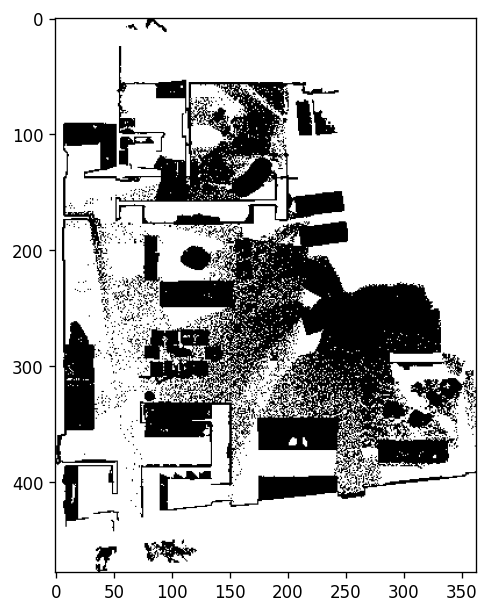

In [35]:
obstacles = load_map(obstacles_save_path)
x_indices, y_indices = np.where(obstacles == 0)

xmin = np.min(x_indices)
xmax = np.max(x_indices)
ymin = np.min(y_indices)
ymax = np.max(y_indices)

print(np.unique(obstacles))
obstacles_pil = Image.fromarray(obstacles[xmin:xmax+1, ymin:ymax+1])
plt.figure(figsize=(8, 6), dpi=120)
plt.imshow(obstacles_pil, cmap='gray')
plt.show()

you can see that the obstacles are black and the free space is white. You can also observe noisy black points lying on the ground. These points are caused by the slope or different floor heights in the scene.

## Show Top-Down Color Map

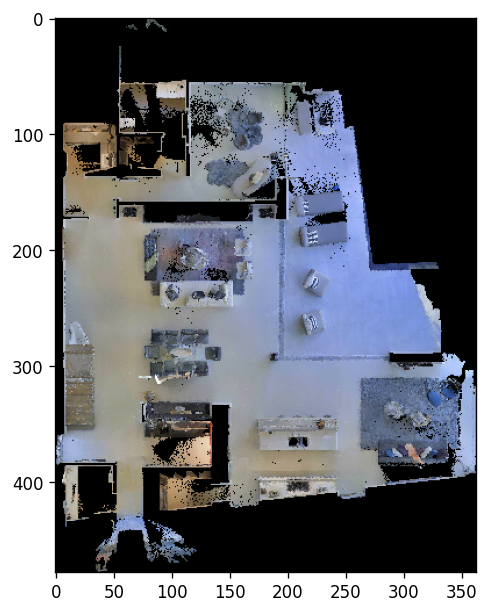

In [36]:
color_top_down = load_map(color_top_down_save_path)
color_top_down = color_top_down[xmin:xmax+1, ymin:ymax+1]
color_top_down_pil = Image.fromarray(color_top_down)
plt.figure(figsize=(8, 6), dpi=120)
plt.imshow(color_top_down_pil)
plt.show()


the color map is created by projecting the color-augmented point cloud to the floor.

## Show Landmark Indexing Results

In [37]:
%%capture
device = "cuda" if torch.cuda.is_available() else "cpu"
clip_version = "ViT-B/32"
clip_feat_dim = {'RN50': 1024, 'RN101': 512, 'RN50x4': 640, 'RN50x16': 768,
                'RN50x64': 1024, 'ViT-B/32': 512, 'ViT-B/16': 512, 'ViT-L/14': 768}[clip_version]
clip_model, preprocess = clip.load(clip_version)  # clip.available_models()
clip_model.to(device).eval()

In [38]:
grid = load_map(grid_save_path)
grid = grid[xmin:xmax+1, ymin:ymax+1]

we use the text form of all semantic categories provided by the Matterport3D dataset as prompts to the VLMap and localize all categories in the map. We filter out "floor" category.

(478, 363)


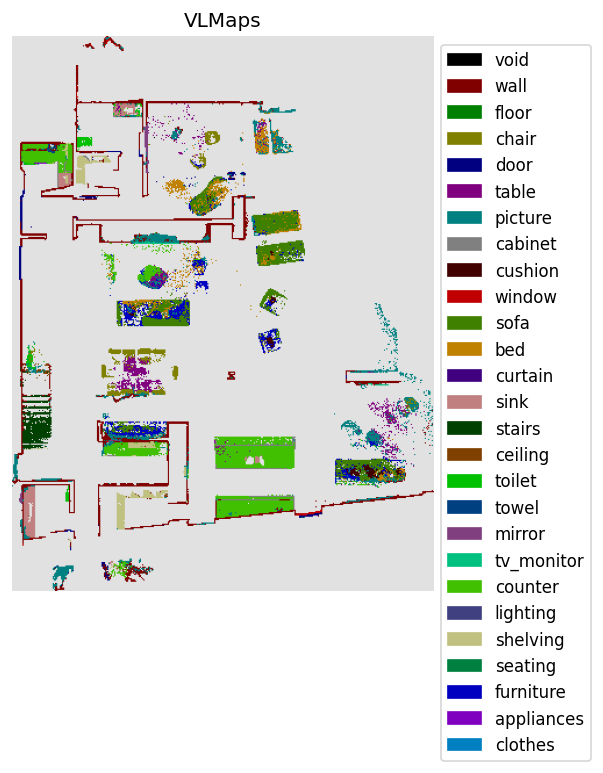

In [39]:
no_map_mask = obstacles[xmin:xmax+1, ymin:ymax+1] > 0
obstacles_rgb = np.repeat(obstacles[xmin:xmax+1, ymin:ymax+1, None], 3, axis=2)
print(no_map_mask.shape)

lang = mp3dcat 
text_feats = get_text_feats(lang, clip_model, clip_feat_dim)

map_feats = grid.reshape((-1, grid.shape[-1]))
scores_list = map_feats @ text_feats.T

predicts = np.argmax(scores_list, axis=1)
predicts = predicts.reshape((xmax - xmin + 1, ymax - ymin + 1))
floor_mask = predicts == 2

new_pallete = get_new_pallete(len(lang))
mask, patches = get_new_mask_pallete(predicts, new_pallete, out_label_flag=True, labels=lang)
seg = mask.convert("RGBA")
seg = np.array(seg)
seg[no_map_mask] = [225, 225, 225, 255]
seg[floor_mask] = [225, 225, 225, 255]
seg = Image.fromarray(seg)
plt.figure(figsize=(10, 6), dpi=120)
plt.legend(handles=patches, loc='upper left', bbox_to_anchor=(1., 1), prop={'size': 10})
plt.axis('off')
plt.title("VLMaps")
plt.imshow(seg)
plt.show()

## Open-Vocabulary Landmark Indexing

In addition to using the fixed set of categories, we can also use customized text prompts to the map and index their corresponding locations. You could play around with the `lang` variable below by providing your own prompt. 

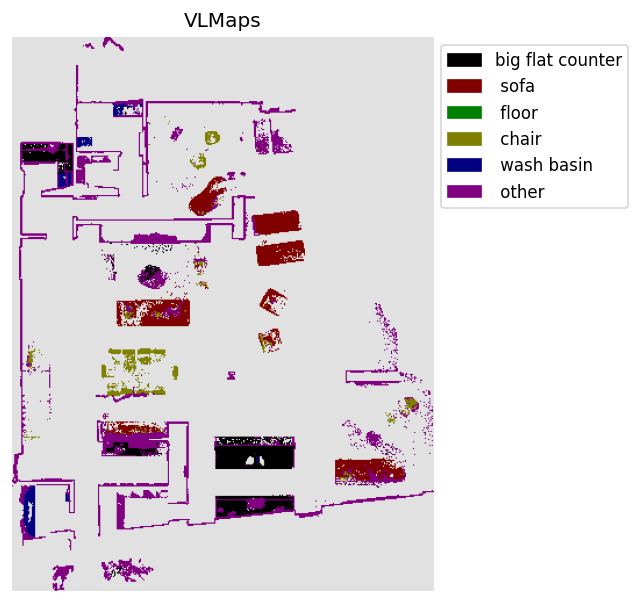

In [40]:
# @markdown Input the prompt as a string of object names separated by ","
lang = "big flat counter, sofa, floor, chair, wash basin, other" # @param {type: "string"}
lang = lang.split(",")
text_feats = get_text_feats(lang, clip_model, clip_feat_dim)

map_feats = grid.reshape((-1, grid.shape[-1]))
scores_list = map_feats @ text_feats.T

predicts = np.argmax(scores_list, axis=1)
predicts = predicts.reshape((xmax - xmin + 1, ymax - ymin + 1))
floor_mask = predicts == 2

new_pallete = get_new_pallete(len(lang))
mask, patches = get_new_mask_pallete(predicts, new_pallete, out_label_flag=True, labels=lang)
seg = mask.convert("RGBA")
seg = np.array(seg)
seg[no_map_mask] = [225, 225, 225, 255]
seg[floor_mask] = [225, 225, 225, 255]
seg = Image.fromarray(seg)
plt.figure(figsize=(10, 6), dpi=120)
plt.legend(handles=patches, loc='upper left', bbox_to_anchor=(1., 1), prop={'size': 10})
plt.axis('off')
plt.title("VLMaps")
plt.imshow(seg)
plt.show()

# Evaluation

Current working directory: C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis
Evaluation Metrics:
Per-class IoU:
  door: 0.998
  chair: 0.015
  ground: 0.788
  ceiling: 0.000
  other: 0.015
Mean IoU: 0.363
Pixel Accuracy: 0.962


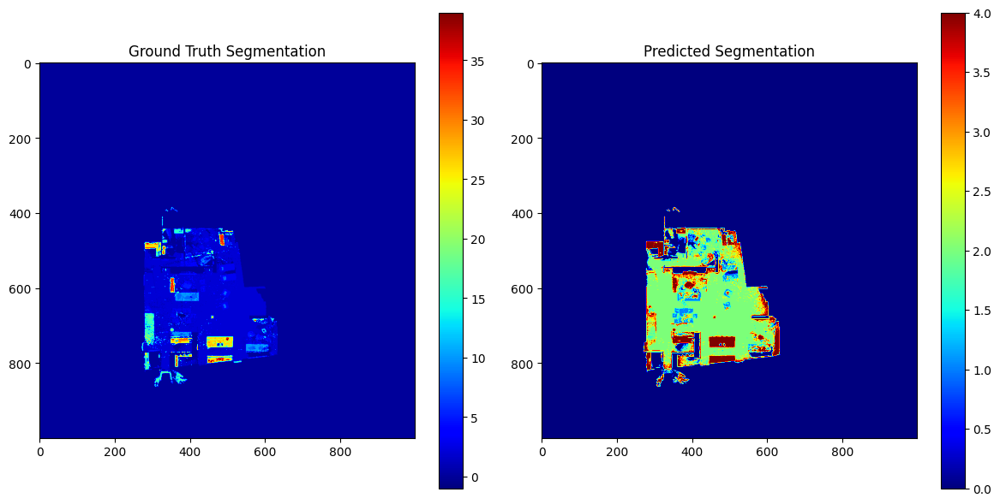

In [41]:
os.chdir(root_dir)
print("Current working directory:", os.getcwd())

# Build the map directory path dynamically
base_map_dir = os.path.join(data_dir, "map")

# Define file paths relative to the base_map_dir
gt_path = os.path.join(base_map_dir, "grid_1_gt.npy")       # Ground truth segmentation map
grid_path = os.path.join(base_map_dir, "grid_lseg_1.npy")     # Grid of visual features from LSeg

def compute_iou(gt, pred, num_classes):
    """Compute per-class Intersection over Union (IoU)."""
    ious = []
    for cls in range(num_classes):
        intersection = np.logical_and(gt == cls, pred == cls).sum()
        union = np.logical_or(gt == cls, pred == cls).sum()
        if union == 0:
            ious.append(np.nan)  # or 0 if you prefer
        else:
            ious.append(intersection / union)
    return ious

def compute_pixel_accuracy(gt, pred):
    """Compute overall pixel accuracy."""
    valid = gt >= 0  # assuming negative labels (if any) are ignore labels
    correct = (gt == pred)[valid].sum()
    total = valid.sum()
    return correct / total

def main():
    # Load ground truth segmentation and grid features.
    gt = np.load(gt_path)    # Expected shape: (gs, gs)
    grid = np.load(grid_path)  # Expected shape: (gs, gs, clip_feat_dim)
    
    # Set up CLIP to extract text features.
    device = "cuda" if torch.cuda.is_available() else "cpu"
    clip_version = "ViT-B/32"
    model, _ = clip.load(clip_version, device=device)
    model.eval()
    
    # Use the same class labels as in your VLMap creation.
    class_labels = ["door", "chair", "ground", "ceiling", "other"]
    
    # Tokenize and encode text to get text features.
    lang_token = clip.tokenize(class_labels).to(device)
    with torch.no_grad():
        text_features = model.encode_text(lang_token)
        text_features = text_features / text_features.norm(dim=-1, keepdim=True)
    text_features = text_features.cpu().numpy()  # Shape: (5, clip_feat_dim)
    
    # Compute predicted segmentation from grid features.
    # grid has shape (gs, gs, clip_feat_dim). Reshape it to (-1, clip_feat_dim)
    gs, _, feat_dim = grid.shape
    grid_feats = grid.reshape(-1, feat_dim)  # Shape: (gs*gs, feat_dim)
    
    # Compute similarity scores between grid features and text features.
    scores = grid_feats @ text_features.T   # Shape: (gs*gs, 5)
    
    # Predicted class per grid cell is the argmax over similarity scores.
    pred_labels = np.argmax(scores, axis=1)  # Shape: (gs*gs,)
    pred_labels = pred_labels.reshape(gt.shape)  # Reshape back to map dimensions
    
    # Compute evaluation metrics.
    num_classes = len(class_labels)
    ious = compute_iou(gt, pred_labels, num_classes)
    pixel_acc = compute_pixel_accuracy(gt, pred_labels)
    mean_iou = np.nanmean(ious)
    
    # Print evaluation results.
    print("Evaluation Metrics:")
    print("Per-class IoU:")
    for label, iou in zip(class_labels, ious):
        print(f"  {label}: {iou:.3f}")
    print(f"Mean IoU: {mean_iou:.3f}")
    print(f"Pixel Accuracy: {pixel_acc:.3f}")
    
    # Visualize the ground truth and predicted segmentation side by side.
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.title("Ground Truth Segmentation")
    plt.imshow(gt, cmap="jet")
    plt.colorbar()
    plt.subplot(1, 2, 2)
    plt.title("Predicted Segmentation")
    plt.imshow(pred_labels, cmap="jet")
    plt.colorbar()
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    main()

Current working directory: C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis
Evaluation Metrics:
Per-class IoU:
  big flat counter: 0.995
  sofa: 0.012
  floor: 0.806
  chair: 0.171
  wash basin: 0.000
  other: 0.045
Mean IoU: 0.338
Pixel Accuracy: 0.969


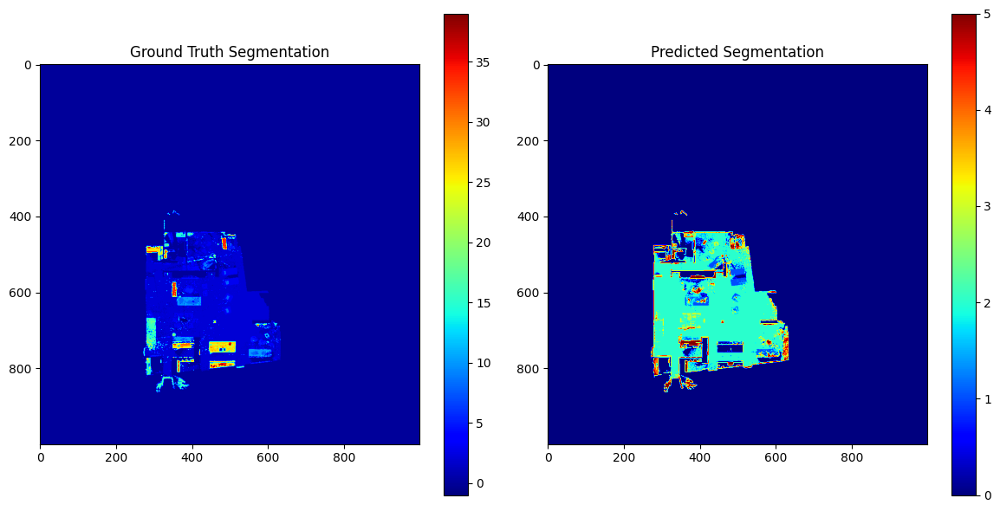

In [42]:
os.chdir(root_dir)
print("Current working directory:", os.getcwd())

# Build the map directory path dynamically
base_map_dir = os.path.join(data_dir, "map")

# Define file paths relative to the base_map_dir
gt_path = os.path.join(base_map_dir, "grid_1_gt.npy")       # Ground truth segmentation map
grid_path = os.path.join(base_map_dir, "grid_lseg_1.npy")     # Grid of visual features from LSeg

def compute_iou(gt, pred, num_classes):
    """Compute per-class Intersection over Union (IoU)."""
    ious = []
    for cls in range(num_classes):
        intersection = np.logical_and(gt == cls, pred == cls).sum()
        union = np.logical_or(gt == cls, pred == cls).sum()
        if union == 0:
            ious.append(np.nan)  # or 0 if you prefer
        else:
            ious.append(intersection / union)
    return ious

def compute_pixel_accuracy(gt, pred):
    """Compute overall pixel accuracy."""
    valid = gt >= 0  # assuming negative labels (if any) are ignore labels
    correct = (gt == pred)[valid].sum()
    total = valid.sum()
    return correct / total

def main():
    # Load ground truth segmentation and grid features.
    gt = np.load(gt_path)    # Expected shape: (gs, gs)
    grid = np.load(grid_path)  # Expected shape: (gs, gs, clip_feat_dim)
    
    # Set up CLIP to extract text features.
    device = "cuda" if torch.cuda.is_available() else "cpu"
    clip_version = "ViT-B/32"
    model, _ = clip.load(clip_version, device=device)
    model.eval()
    
    # Use the same class labels as in your VLMap creation.
    class_labels = ["big flat counter", "sofa", "floor", "chair", "wash basin", "other"]
    
    # Tokenize and encode text to get text features.
    lang_token = clip.tokenize(class_labels).to(device)
    with torch.no_grad():
        text_features = model.encode_text(lang_token)
        text_features = text_features / text_features.norm(dim=-1, keepdim=True)
    text_features = text_features.cpu().numpy()  # Shape: (5, clip_feat_dim)
    
    # Compute predicted segmentation from grid features.
    # grid has shape (gs, gs, clip_feat_dim). Reshape it to (-1, clip_feat_dim)
    gs, _, feat_dim = grid.shape
    grid_feats = grid.reshape(-1, feat_dim)  # Shape: (gs*gs, feat_dim)
    
    # Compute similarity scores between grid features and text features.
    scores = grid_feats @ text_features.T   # Shape: (gs*gs, 5)
    
    # Predicted class per grid cell is the argmax over similarity scores.
    pred_labels = np.argmax(scores, axis=1)  # Shape: (gs*gs,)
    pred_labels = pred_labels.reshape(gt.shape)  # Reshape back to map dimensions
    
    # Compute evaluation metrics.
    num_classes = len(class_labels)
    ious = compute_iou(gt, pred_labels, num_classes)
    pixel_acc = compute_pixel_accuracy(gt, pred_labels)
    mean_iou = np.nanmean(ious)
    
    # Print evaluation results.
    print("Evaluation Metrics:")
    print("Per-class IoU:")
    for label, iou in zip(class_labels, ious):
        print(f"  {label}: {iou:.3f}")
    print(f"Mean IoU: {mean_iou:.3f}")
    print(f"Pixel Accuracy: {pixel_acc:.3f}")
    
    # Visualize the ground truth and predicted segmentation side by side.
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.title("Ground Truth Segmentation")
    plt.imshow(gt, cmap="jet")
    plt.colorbar()
    plt.subplot(1, 2, 2)
    plt.title("Predicted Segmentation")
    plt.imshow(pred_labels, cmap="jet")
    plt.colorbar()
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    main()

In [44]:
np.save(r"C:\Users\Marlo\Documents\education\qmul\modules\master-thesis\code\changes\MSc-Thesis\data\my_maps\pred_map.npy", predicts)

# Citation
If you find this code useful to you, please cite our paper. You can find more results on the website of our paper [here](https://vlmaps.github.io/).
```
@article{huang22vlmaps,
  title     = {Visual Language Maps for Robot Navigation},
  author    = {Chenguang Huang and Oier Mees and Andy Zeng and Wolfram Burgard},
  journal   = {arXiv preprint arXiv:2210.05714},
  year      = {2022},
}
```